In [4]:
import warnings
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
# import gseapy as gp
# import squidpy as sq
from bin import load_bgi as ld
import seaborn as sns
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)
sc.settings.verbosity = 3
# import time
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import shapiro, norm
from scipy.signal import find_peaks
import os

%config InlineBackend.figure_format='retina'
%matplotlib inline
plt.rcParams['figure.figsize']=(7,4)


In [5]:
def calculate_composition(adata, groupby_key, category_key):
    """
    Calculate the composition of categories within each group.

    Parameters:
    adata: AnnData object
    groupby_key: Key in adata.obs to group by (e.g., 'louvain')
    category_key: Key in adata.obs for categories (e.g., 'annotations')

    Returns:
    Pandas DataFrame with composition data.
    """
    # Create a DataFrame from the AnnData object
    data = pd.DataFrame(adata.obs)
    # Calculate composition
    composition = data.groupby(groupby_key)[category_key].value_counts(normalize=True).unstack(fill_value=0)
    return composition


def plot_composition(composition_df, title, x, y, palette='viridis'):
    """
    Plot the composition data as a stacked bar plot.
    Parameters:
    composition_df: DataFrame with composition data
    title: Title for the plot
    """
    if isinstance(palette, str):
        cmap = plt.get_cmap(palette)
        colors = cmap(np.linspace(0, 1, composition_df.shape[1]))
    elif isinstance(palette, list):
        colors = palette
    else:
        raise ValueError("Palette should be a string (colormap name) or a list of colors")
    
    # Create the plot
    ax = composition_df.plot(kind='bar', stacked=True, figsize=(6, 4), color=colors, fontsize=8)
    
    # Set title and labels
    plt.title(title)
    plt.ylabel('Proportion')
    plt.xlabel(x)

    # Customize the legend
    plt.legend(title=y, bbox_to_anchor=(1.05, 1), loc='upper left')

    # Remove the top and right spines
    sns.despine()

    # Optional: Remove grid lines
    ax.yaxis.grid(False)  # Remove horizontal grid lines
    ax.xaxis.grid(False)  # Remove vertical grid lines

    plt.tight_layout()
    plt.show()

In [6]:
import json

with open("/home/zhanghr/Analysis/script/spatial-gRNA/Infiltration/marker_stage1.json", "r") as json_file:
    marker_stage1 = json.load(json_file)

with open("/home/zhanghr/Analysis/script/spatial-gRNA/Infiltration/marker_stage2.json", "r") as json_file:
    marker_stage2 = json.load(json_file)
    

In [7]:
# 转换大小写
def convert_gene_names(genes):
    return [gene.capitalize() for gene in genes]

# Apply the conversion to each gene list in the dictionary
marker_stage1 = {category: convert_gene_names(genes) for category, genes in marker_stage1.items()}
marker_stage2 = {category: convert_gene_names(genes) for category, genes in marker_stage1.items()}

marker_stage1


{'NK': ['Ptprc',
  'Klrd1',
  'Mrpl47',
  'Ncr1',
  'Nkg7',
  'Gnly',
  'Klrk1',
  'Klrc1',
  'Gzmb',
  'Klrf1'],
 'T': ['Ptprc',
  'Cd3d',
  'Cd3g',
  'Cd3e',
  'Cd8a',
  'Cd4',
  'Trbc1',
  'Trbc2',
  'Trac',
  'Gnly',
  'Klrg1',
  'Gzmb',
  'Prf1',
  'Gzmk',
  'Ccr7',
  'Il7r',
  'Sell',
  'Lef1',
  'Tcf7',
  'Lag3',
  'Layn',
  'Havcr2',
  'Ctla4',
  'Ggt1',
  'Tigit',
  'Cd160',
  'Tox',
  'Prdm1',
  'Socs1',
  'Eomes',
  'Tbx21',
  'Batf',
  'Foxo1',
  'Cd4',
  'Foxp3',
  'Gata3',
  'Tbx21',
  'Cxcr3',
  'Cd8b'],
 'B': ['Ptprc',
  'Cd19',
  'Tnfrsf17',
  'Cd79a',
  'Cd79b',
  'Slamf7',
  'Igkc',
  'Ms4a1'],
 'Plasma': ['Cd79a', 'Mzb1', 'Jchain', 'Igha1', 'Ighg1', 'Mki67'],
 'Neutrophils': ['Ptprc', 'S100a9', 'Mpo', 'Cxcr2', 'Csf3r', 'Aqp9'],
 'Macrophages': ['Ptprc',
  'Cd14',
  'Itgam',
  'Itgax',
  'Trem2',
  'Fcgr3a',
  'Fcgr3b',
  'Ccr2',
  'Cd163',
  'Cd68',
  'Arg1',
  'Adgre1',
  'Cd33',
  'Cd68',
  'C1qa',
  'Cd163',
  'C1qb',
  'C1qc',
  'Marco',
  'Cd81'],
 'DC': ['Ptpr

In [ ]:
gem_file = "/home/zhaoyp/0.CRLM_ST/data/gem_data/CRLM/20230725_CC/results/D03062C2.tissue.gem.gz"
#image_file = "/home/zhaoyp/0.CRLM_ST/data/gem_data/20230725_CC_tissue.tif"
library_id = "st"
#mask_file = "/home/zhaoyp/0.CRLM_ST/data/gem_data/20230725_CC_tissue.npy"


In [8]:
from collections import defaultdict

marker_dict = defaultdict(list)

for key in marker_stage1.keys():
    marker_dict[key].extend(marker_stage1[key])

for key in marker_stage2.keys():
    marker_dict[key].extend(marker_stage2[key])

for key, value in marker_dict.items():
    marker_dict[key] = list(set(marker_dict[key]))

In [9]:
dict_ref = {
    "NK": ["NK"], 
    "T": ["T"], 
    "B": ["B", "Plasma"], 
    # "Neutrophils": ["Neutrophils"],
    "Macrophages": ["Macrophages","Monocyte"],
    "DC": ["DC"],
    "Endothelial":["Endothelial"],
    "Fibroblast": ["Fibroblasts","Myofibroblast"],
    'MuscleCell':["SmoothMuscle"],
    "Epithelial": [ "Malignant", "Epithelial"],
    "Hepatocytes": ["Hepatocytes/cholangiocytes"]}

epithelial_marker_2 = {
    # "Arterial": ["SOX17", "EFNB2", "GJA5", "DKK2", "FBLN5", "HEY1", "IGFBP3"],  "Postcapillary vains": ["ACKR1", "SELP", "VCAM1"], "Capillaries": ["CA4", "CD36", "IL7R", "AFF3", "BTNL9"],
    # "Epithelial": ['PIGR', 'PHGR1', 'ITM2C', 'MT1E', 'CA2', 'MT1G', 'MT2A', 'VSIG2', 'TSPAN1', 'FABP1', 'MT1M', 'PLAC8', 'FCGBP', 'PKIB', 'GUCA2A', 'MT1F', 'LYPD8', 'PADI2', 'MT1H', 'MUC4', 'ZG16', 'FABP2', 'PLA2G2A', 'B3GNT7', 'GUCA2B', 'CEACAM7', 'BCAS1', 'CA4', 'SLC4A4', 'UGT2B17', 'XIST', 'CHP2', 'CA1', 'C2orf88', 'CPM', 'DHRS9', 'HRCT1', 'HSD17B2', 'CD177', 'ENTPD8', 'B3GALT5', 'CLCA4', 'ADH1C', 'SLC26A3', 'NXPE4', 'GPT', 'SCIN', 'ITLN1', 'CA7', 'SLC16A9', 'MS4A12', 'SPIB', 'SCNN1B', 'SLC17A4', 'NEURL1', 'CTSE', 'BEST4', 'OTOP2', 'REP15', 'NR3C2', 'ADTRP', 'AKR1B10', 'SI', 'SPINK5', 'AQP8', 'BTNL8', 'SLC51B', 'MMP28', 'CLCA1', 'TPSG1', 'EDN3', 'CLDN8', 'LGALS9B', 'TMIGD1', 'GPAT3', 'CPNE8', 'LGALS9C', 'LAMA1', 'RNF152', 'C11orf86', 'LDHD', 'TMEM236', 'BEST2', 'SULT1A2', 'HRASLS2', 'ABCG2', 'SCGB2A1', 'SLCO2A1', 'TMEM82', 'BMP3', 'KCNMA1', 'CEACAM3', 'TBX10', 'FAM177B', 'MYOM1', 'FSIP2', 'MEIS1', 'UGT2B15', 'SLC28A2', 'B3GNT6'],
    "Epithelial":['EPCAM'],
    "Malignant": ['ASCL2', 'TGFBI', 'NKD1', 'DPEP1', 'BMP4', 'GNG4', 'DACH1', 'CLDN1', 'KRT23', 'ETV4', 'SP5', 'NOTUM', 'TESC', 'TDGF1', 'FOXQ1', 'APCDD1', 'C2', 'SNTB1', 'GPR155', 'SLC7A5', 'SLC29A1', 'LGR5', 'BAMBI', 'MTRNR2L12', 'MATR3', 'COL9A3', 'DEFA5', 'CAB39L', 'MTRNR2L8', 'ACSL6', 'PLCB1', 'FKBP10', 'CEMIP', 'FZD10', 'DEFA6', 'PEG10', 'PTP4A3', 'KIZ', 'KRT5', 'PLTP', 'ETV5', 'CST1', 'BMP7', 'WFS1', 'GAL', 'STXBP1', 'CELF3', 'GLIPR1', 'CEL', 'NR2F1', 'SEMA3A', 'FILIP1L', 'CYP2W1', 'LEF1', 'BOP1', 'SMOC2', 'MUCL1', 'FGF20', 'PACSIN3', 'EDAR', 'IGF2BP3', 'RBMS1', 'GAD1', 'TNFRSF19', 'PROCR', 'TGFBR3', 'LGR6', 'ABHD12B', 'CXCL14', 'VGF', 'MEX3A', 'OSR2', 'NRCAM', 'INHBB', 'FAM89A', 'NKD2', 'STMN3', 'DEPDC7', 'STC2', 'LAMA5', 'KCNMB4', 'DKK4', 'CKMT2', 'TMEM154', 'CAPN6', 'FADS1', 'PLAG1', 'DLX3', 'FBLN1', 'MSX1', 'FOXD1', 'TMEM132C', 'BAG2', 'OLFML3', 'TIMP3', 'UPK1A', 'SMIM3', 'CELF4', 'FGF19', 'PALD1'],
}

marker_dict_0 = {}
for new_key, old_keys in dict_ref.items():
    merged_list = []
    for old_key in old_keys:
        merged_list.extend(marker_dict.get(old_key, []))
    marker_dict_0[new_key] = merged_list

for i, j in marker_dict_0.items():
    print(f"Cell type of {i} has {len(j)} markers.")

marker_dict_CC = {key:val for key, val in marker_dict_0.items() if key!="Hepatocytes"}
marker_dict_LM = marker_dict_0


Cell type of NK has 10 markers.
Cell type of T has 37 markers.
Cell type of B has 14 markers.
Cell type of Macrophages has 18 markers.
Cell type of DC has 14 markers.
Cell type of Endothelial has 5 markers.
Cell type of Fibroblast has 7 markers.
Cell type of MuscleCell has 10 markers.
Cell type of Epithelial has 39 markers.
Cell type of Hepatocytes has 10 markers.


In [10]:
import itertools

# Generate all combinations of keys in the dictionary
key_combinations = itertools.combinations(marker_dict_0.keys(), 2)

# Iterate over combinations and find common elements
for keys in key_combinations:
    key1, key2 = keys
    common_elements = set(marker_dict[key1]).intersection(marker_dict_0[key2])
    if common_elements:
        print(f"Common elements between '{key1}' and '{key2}': {common_elements}")

Common elements between 'NK' and 'T': {'Gzmb', 'Ptprc', 'Gnly'}
Common elements between 'NK' and 'B': {'Ptprc'}
Common elements between 'NK' and 'Macrophages': {'Ptprc'}
Common elements between 'NK' and 'DC': {'Ptprc'}
Common elements between 'T' and 'B': {'Ptprc'}
Common elements between 'T' and 'Macrophages': {'Ptprc'}
Common elements between 'T' and 'DC': {'Ptprc'}
Common elements between 'B' and 'Macrophages': {'Ptprc'}
Common elements between 'B' and 'DC': {'Ptprc'}
Common elements between 'Macrophages' and 'DC': {'Cd68', 'Cd33', 'Itgam', 'Itgax', 'Ptprc', 'Cd14'}
Common elements between 'Endothelial' and 'MuscleCell': {'Mgp'}


In [11]:
fibroblast_marker_2 = {
    "myCAF": ["ACTA2", "POSTN", "INHBA", "MMP11", "ASPN", "PDGFRA", "LUM", "DCN"],
    "apCAF": ["HLA-DRA", "HLA-DRB1", "CD74"],
    "iCAF": ["IL6", "CXCL12", "CXCL14"],
    "Vascular CAF": ["NOTCH3", "COL18A1"],
    "Reticular-like CAF": ["CCL21", "CCL19"],
}

In [12]:
fibroblast_marker_2 = {category: convert_gene_names(genes) for category, genes in fibroblast_marker_2.items()}
fibroblast_marker_2

{'myCAF': ['Acta2', 'Postn', 'Inhba', 'Mmp11', 'Aspn', 'Pdgfra', 'Lum', 'Dcn'],
 'apCAF': ['Hla-dra', 'Hla-drb1', 'Cd74'],
 'iCAF': ['Il6', 'Cxcl12', 'Cxcl14'],
 'Vascular CAF': ['Notch3', 'Col18a1'],
 'Reticular-like CAF': ['Ccl21', 'Ccl19']}

In [17]:
1

1

In [13]:
from skimage.morphology import dilation, square
from tqdm import tqdm


def compute_relative_abundance(adata, dict_use):
    relative_abundances = {}
    for cell_type, markers in tqdm(dict_use.items()):
        avg_expressions = []
        for marker in markers:
            if marker not in adata.var_names:
                continue
            expressed_values = adata[:, marker].X[adata[:, marker].X > 0]
            # Check if there are any expressed values
            if isinstance(expressed_values, np.ndarray):
                num_nonzero = len(expressed_values)
            else:  # Assuming it's a sparse matrix
                num_nonzero = expressed_values.getnnz()
            if num_nonzero > 0:
                avg_expressions.append(np.mean(expressed_values))
            else:
                avg_expressions.append(0)
        relative_abundance = np.log10(sum(avg_expressions) + 1e-10)
        relative_abundances[cell_type] = 1 / relative_abundance
    return relative_abundances


def annotate_cells_stage(marker_dict_use, adata, cells_to_annotate=None):
    WCT = compute_relative_abundance(adata, marker_dict_use)
    annotations = {}
    unannotated_cells = []

    if cells_to_annotate is None:
        cells_to_annotate = adata.obs_names
        data_submatrix = adata.X
    else:
        data_submatrix = adata[cells_to_annotate, :].X

    all_scores = np.zeros((len(cells_to_annotate), len(marker_dict_use)))
    print(all_scores.shape)
    for idx, (cell_type, markers) in enumerate(marker_dict_use.items()):
        valid_markers_indices = [
            adata.var_names.get_loc(marker)
            for marker in markers
            if marker in adata.var_names
        ]
        marker_matrix = data_submatrix[:, valid_markers_indices]
        presence_matrix = (marker_matrix > 0).astype(int)
        scores = presence_matrix.sum(axis=1) * WCT[cell_type]

        all_scores[:, idx] = scores.ravel()
    max_scores = np.max(all_scores, axis=1)
    max_score_indices = np.argmax(all_scores, axis=1)
    cell_types = list(marker_dict_use.keys())
    annotations = np.array(
        [
            cell_types[idx] if score > 0 else "Others"
            for idx, score in zip(max_score_indices, max_scores)
        ]
    )
    unannotated = [cells_to_annotate[i] for i in np.where(annotations == "Others")[0]]
    return dict(zip(cells_to_annotate, annotations)), unannotated

def visualize_results(adata, key="annotations"):
    # Plotting
    cell_types, counts = np.unique(adata.obs[key], return_counts=True)
    plt.bar(cell_types, counts)
    # Annotate each bar with its value
    for i, value in enumerate(counts):
        plt.text(i, value, str(value), ha="center", va="bottom", fontsize=8)
    plt.xticks(rotation=90)
    plt.ylabel("Number of Cells")
    plt.xlabel("Cell Types")
    plt.title("Cell Type Annotations")
    plt.show()

In [14]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%config InlineBackend.figure_format = 'png'
%config InlineBackend.print_figure_kwargs = {'dpi': 600}

#  保存 h5ad 文件

## Bin20

In [32]:
fdata = sc.read_h5ad('./RNA/Multitime.annotation.sort.h5')

1-1
1-2
2-1
AnnData object with n_obs × n_vars = 567964 × 13177
    obs: 'marker', 'annotations', 'cov', 'cluster'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: 'rank_genes_groups'
    obsm: 'spatial'
filtered out 237 cells that have less than 1 genes expressed
AnnData object with n_obs × n_vars = 567727 × 13177
    obs: 'marker', 'annotations', 'cov', 'cluster', 'n_genes'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: 'rank_genes_groups'
    obsm: 'spatial'
normalizing counts per cell
    finished (0:00:00)
AnnData object with n_obs × n_vars = 567727 × 13177
    obs: 'marker', 'annotations', 'cov', 'cluster', 'n_genes'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: 'rank_genes_groups', 'log1p'
    obsm: 'spatial'
    layers: 'counts'


100%|██████████| 9/9 [00:36<00:00,  4.05s/it]


(567727, 9)
There are 45570 cells remaining unannotated.


100%|██████████| 2/2 [00:00<00:00, 32.36it/s]


(125644, 2)


100%|██████████| 2/2 [00:02<00:00,  1.11s/it]


(125203, 2)


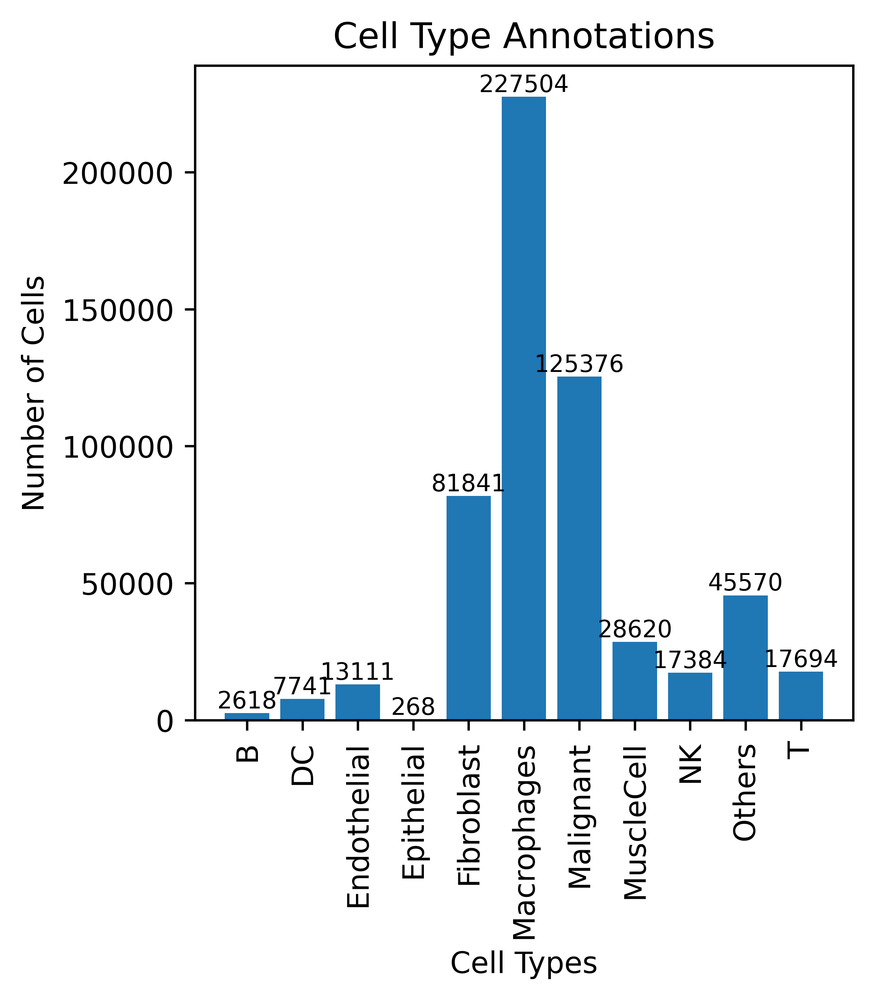

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


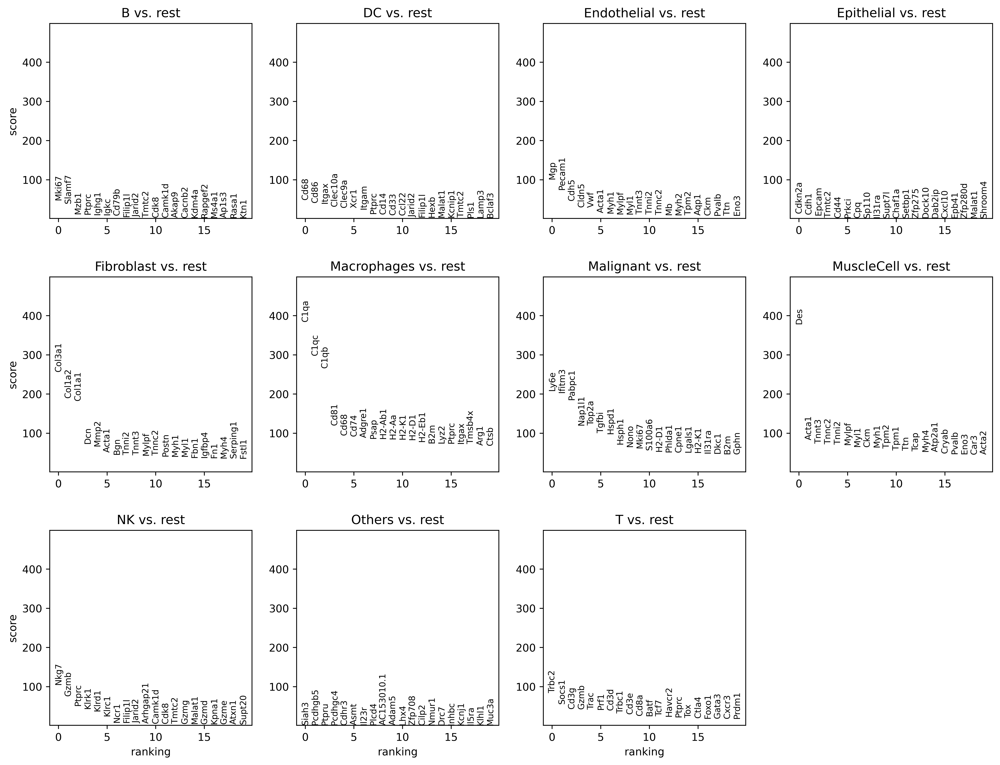

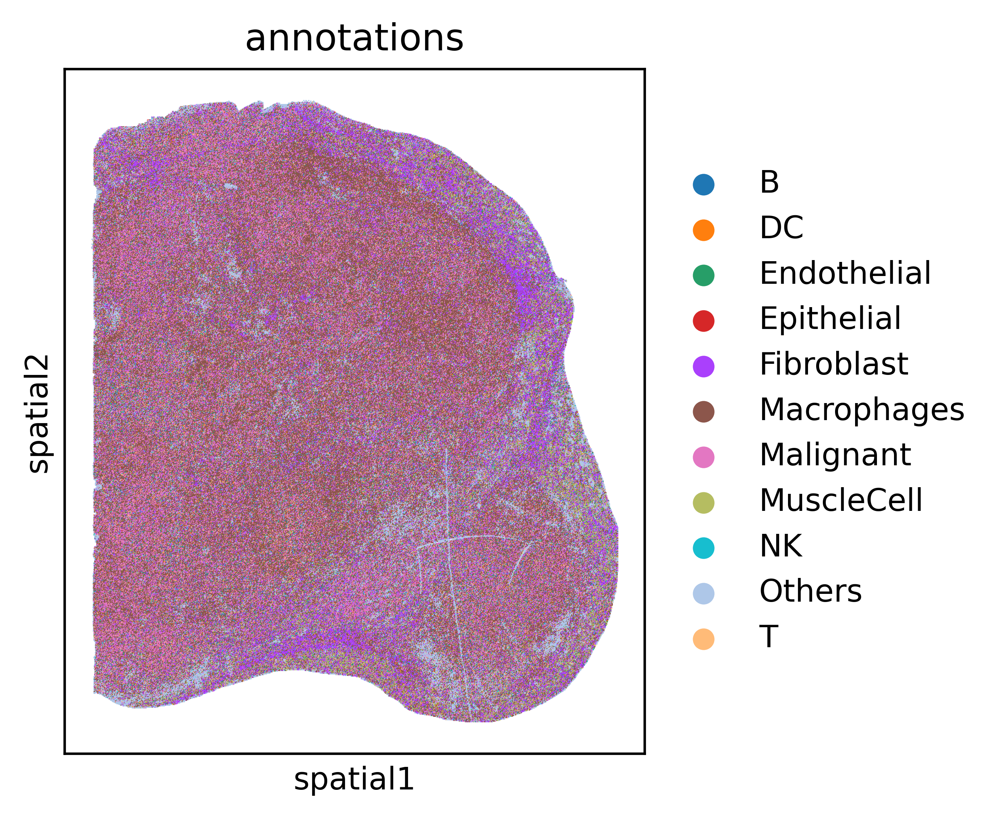

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:17)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:56)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:13:32)
running Leiden clustering
    finished: found 40 clusters and added
    'GEX_leiden', the cluster labels (adata.obs, categorical) (0:09:47)
ranking genes


/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/wpy/miniconda3/envs/scanpy/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWa

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:22)


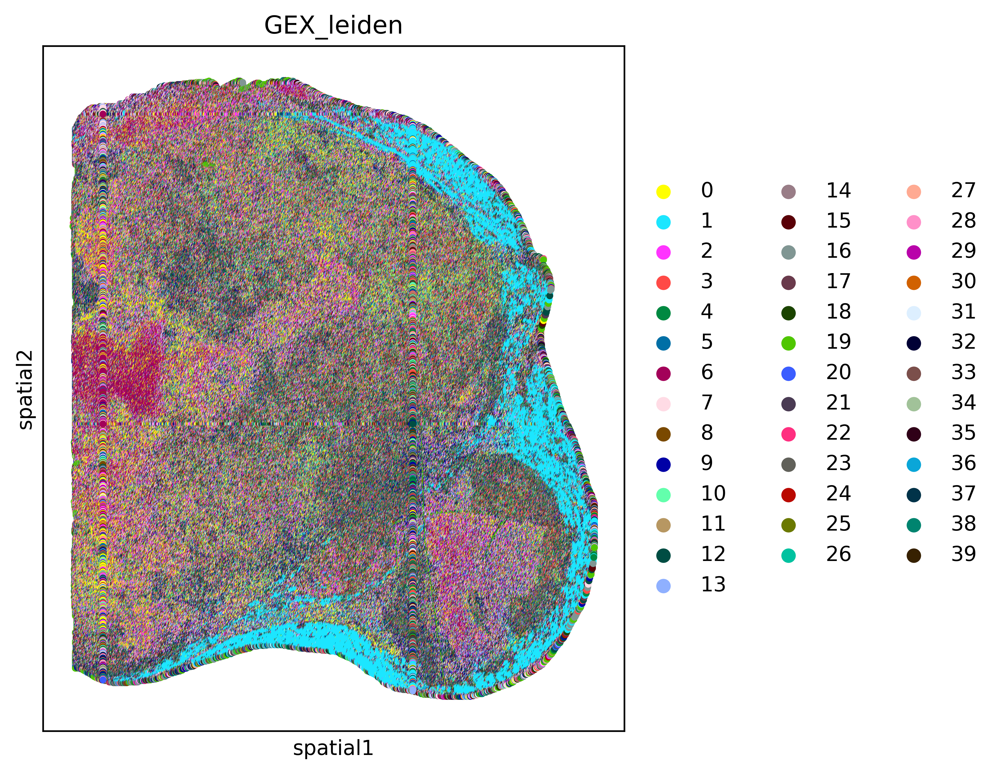

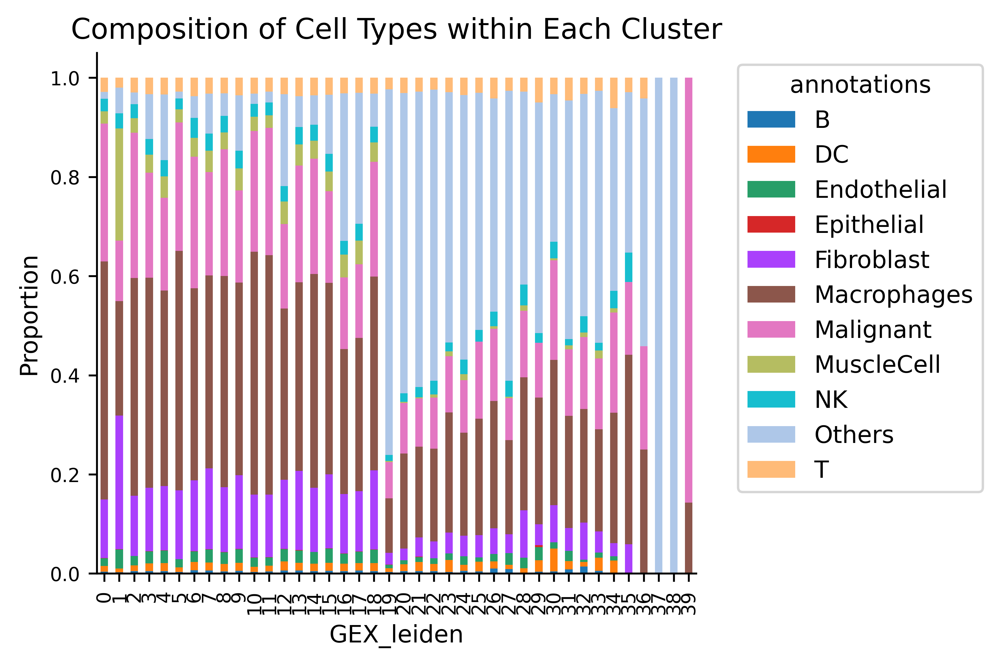

2-2
3-1
3-2


: 

In [39]:
import os

samples = ["cut.combined.D03658A3.merged.sgRNA.gem", "cut.combined.D03658A6.merged.sgRNA.gem"]

fdata = sc.read_h5ad('./RNA/Multitime.annotation.sort.h5')
for marker in np.unique(fdata.obs["marker"]):
    print(marker)
    if marker != "2-1": continue

    #gem_file = '/home/zhanghr/Analysis/data/combined/' + sample + "/results/"
    #file_name = [x for x in os.listdir(gem_file) if "tissue.gem.gz" in x][0]
    gem_file = "/home/zhanghr/Analysis/data/cut_combined/" + sample
    #image_file = None
    library_id = "st"
    # mask_file = "/home/zhaoyp/0.CRLM_ST/data/gem_data/" + sample + "_tissue.npy"

    #adata = ld.load_bin(gem_file= gem_file, image_file = None, bin_size=20, library_id='st')

    adata = fdata[fdata.obs["marker"] == marker].copy()
    print(adata)
    # sc.pp.filter_cells(adata, max_genes=10000)
    sc.pp.filter_cells(adata, min_genes=1)
    # sc.pp.filter_genes(adata, min_cells=50)
    # adata.var["mt"] = adata.var_names.str.startswith("Mt-")
    # sc.pp.calculate_qc_metrics(
    #     adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    # ) 
    print(adata)
    adata.layers['counts'] = adata.X
    #adata.X = adata.layers['counts']
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    print(adata)

    marker_dict_1 = marker_dict_CC


    annotations, unannotated_cells = annotate_cells_stage(marker_dict_1, adata)
    print("There are {} cells remaining unannotated.".format(len(unannotated_cells)))
    adata.obs["annotations"] = pd.Series(annotations).astype("category")

    adata_epi = adata[adata.obs["annotations"] == "Epithelial", :].copy()
    annotations, unannotated_cells_stage_1 = annotate_cells_stage(epithelial_marker_2, adata_epi)
    annotations_stage_2, unannotated = annotate_cells_stage( {key:val for key, val in marker_stage1.items() if key in ["Malignant", "Epithelial"]}, adata_epi,
                                                            cells_to_annotate=unannotated_cells_stage_1) 
    for idx, ann in annotations_stage_2.items():
        annotations[idx] = ann
    adata_epi.obs["anno_1"] = pd.Series(annotations).astype("category")
    adata_epi.obs['anno_1'] = np.array(adata_epi.obs['anno_1'])
    adata.obs["annotations"] = np.array(adata.obs["annotations"])
    adata.obs.loc[adata_epi.obs.index, "annotations"] = adata_epi.obs['anno_1']
    
    
    adata.obs["annotations"] = pd.Series(adata.obs["annotations"]).astype("category")
    #adata.obs['annotations'] = adata.obs['annotations'].cat.reorder_categories(['NK', 'T', 'B', 'DC', 'Macrophages', 'Epithelial', 'Malignant', 'Endothelial', 'Fibroblast', 'MuscleCell', 'Others'], ordered = True)
  
    visualize_results(adata)
    plt.rcParams['figure.figsize']=(4,4)
    try:
        sc.tl.rank_genes_groups(adata, groupby='annotations') 
        sc.pl.rank_genes_groups(adata)
    except:
        print('skip')

    sc.pl.spatial(adata, color=["annotations"], size=2, img_key=None, spot_size=20)


    adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
    #adata.write_h5ad('/home/zhanghr/Analysis/data/celltype/'+ sample + ".h5ad")

    ### Cluster
    sc.pp.highly_variable_genes(adata, n_top_genes=3000)
    adata.raw = adata.copy()
    adata = adata[:,adata.var['highly_variable']]   
    sc.tl.pca(adata, svd_solver="arpack")
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=1.2, key_added='GEX_leiden')
    sc.tl.rank_genes_groups(adata, groupby='GEX_leiden') 
    sc.pl.rank_genes_groups(adata)
    plt.rcParams["figure.figsize"] = (6, 6)
    sc.pl.spatial(adata, img_key=None, color="GEX_leiden", size=2, spot_size=100)

    cluster_composition = calculate_composition(adata, 'GEX_leiden', 'annotations')
    plot_composition(cluster_composition, 'Composition of Cell Types within Each Cluster', "GEX_leiden", "annotations", palette=list(adata.uns['annotations_colors']))

    adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
    #adata.write_h5ad('/home/zhanghr/Analysis/data/celltype/'+ sample + "_3kHVGsCluster.h5ad")
    del(adata)
    #break


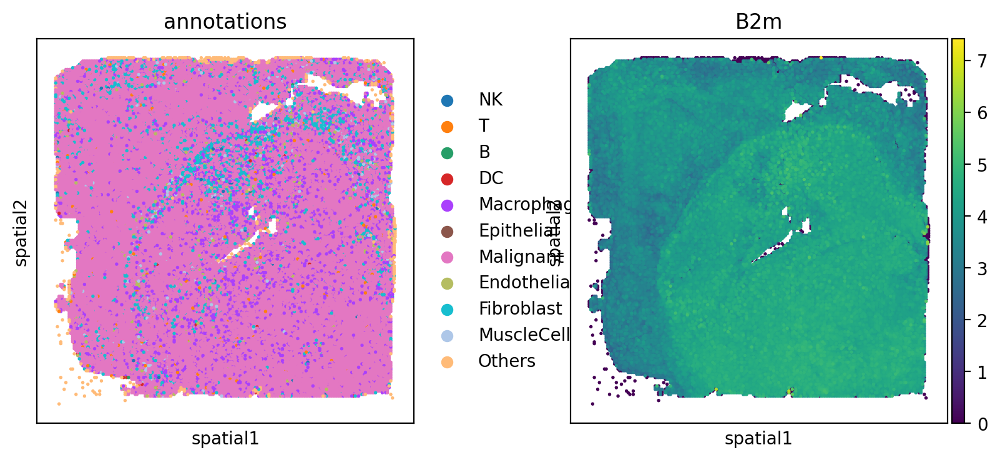

In [27]:
  sc.pl.spatial(adata, color=["annotations",'B2m'],size=2, img_key=None, spot_size=100)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:10)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:28)
computing neighbors
    using 'X_pca' with n_pcs = 50


/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-pac

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:28)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:41)
running Leiden clustering
    finished: found 10 clusters and added
    'GEX_leiden', the cluster labels (adata.obs, categorical) (0:00:12)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:17)


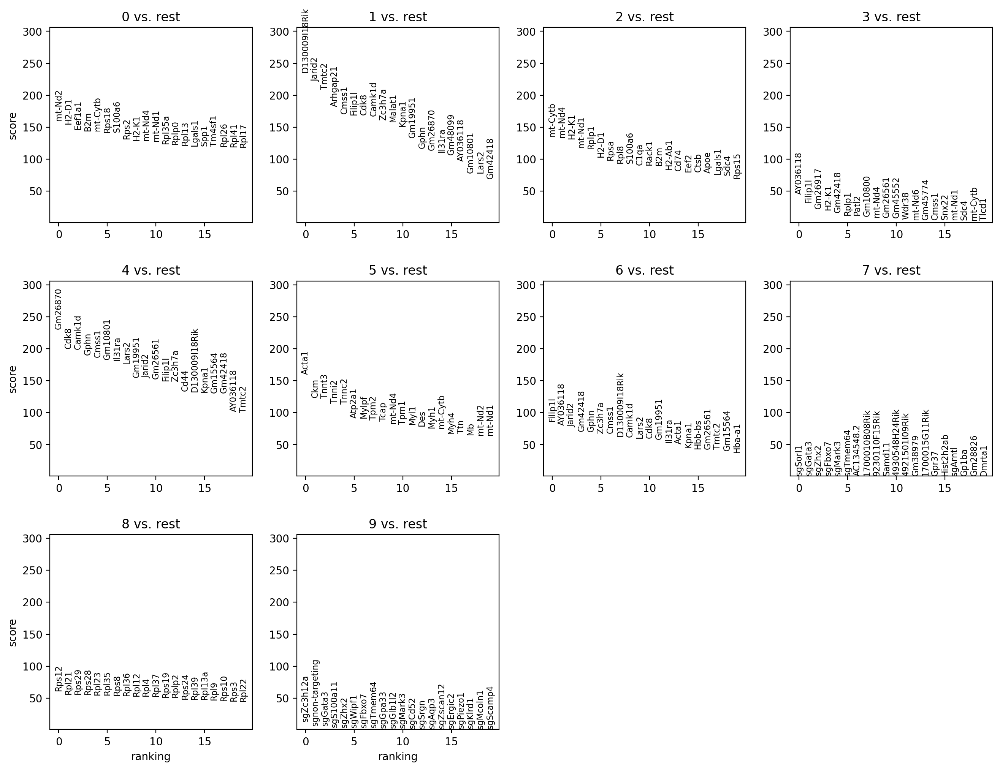

ValueError: When .uns['spatial'][library_id] does not exist, spot_size must be provided directly.

In [29]:
   ### Cluster
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
adata.raw = adata.copy()
adata = adata[:,adata.var['highly_variable']]   
sc.tl.pca(adata, svd_solver="arpack")
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata,key_added='GEX_leiden')
sc.tl.rank_genes_groups(adata, groupby='GEX_leiden') 
sc.pl.rank_genes_groups(adata)
plt.rcParams["figure.figsize"] = (4.5, 4.5)
sc.pl.spatial(adata, img_key=None, color="GEX_leiden", size=2, spot_size=100)

cluster_composition = calculate_composition(adata, 'GEX_leiden', 'annotations')
plot_composition(cluster_composition, 'Composition of Cell Types within Each Cluster', "GEX_leiden", "annotations", palette=list(adata.uns['annotations_colors']))

adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
adata.write_h5ad('/home/zhanghr/Analysis/data/'+ sample + "_3kHVGsCluster.h5ad")


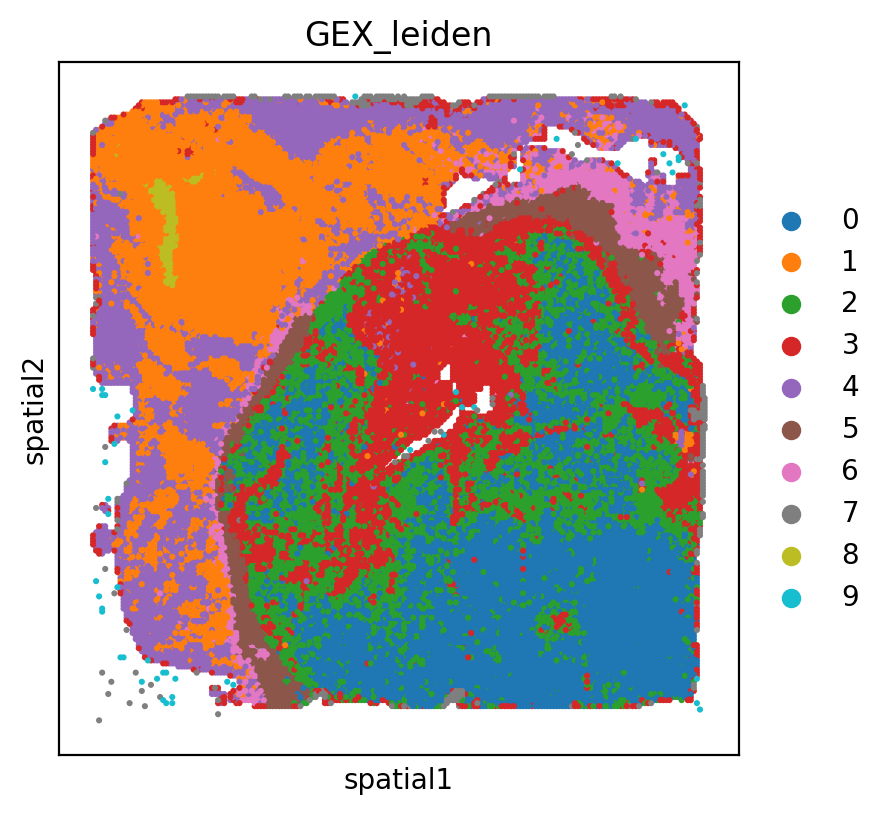

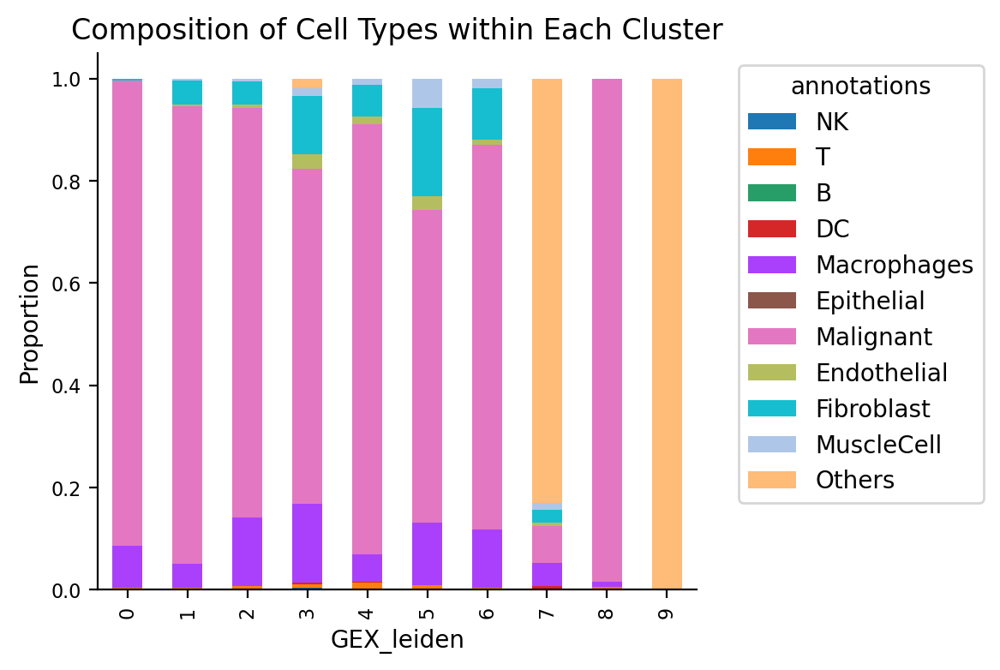

In [30]:
sc.pl.spatial(adata, img_key=None, color="GEX_leiden", size=2, spot_size=100)

cluster_composition = calculate_composition(adata, 'GEX_leiden', 'annotations')
plot_composition(cluster_composition, 'Composition of Cell Types within Each Cluster', "GEX_leiden", "annotations", palette=list(adata.uns['annotations_colors']))


In [26]:
del(adata)

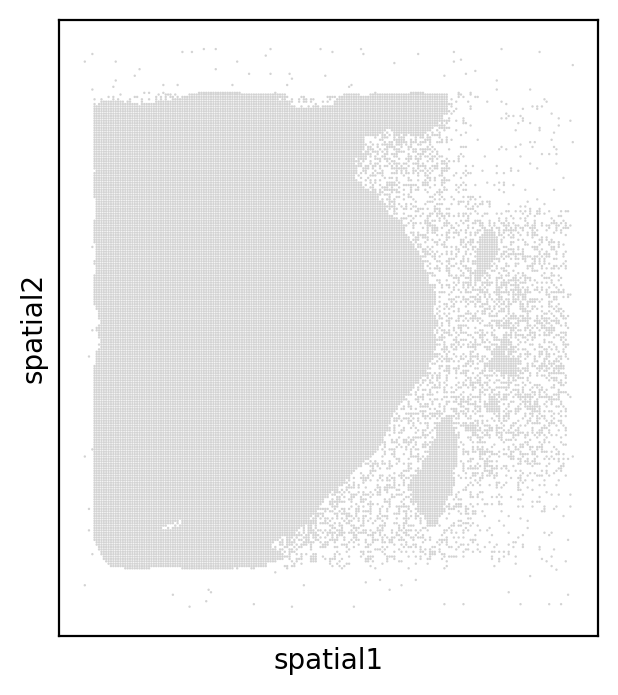

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:11)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:27)
computing neighbors
    using 'X_pca' with n_pcs = 50


/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-pac

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:32)
running Leiden clustering
    finished: found 50 clusters and added
    'GEX_leiden', the cluster labels (adata.obs, categorical) (0:00:05)
ranking genes


/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/zhanghr/app/miniconda3/envs/span/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:16)


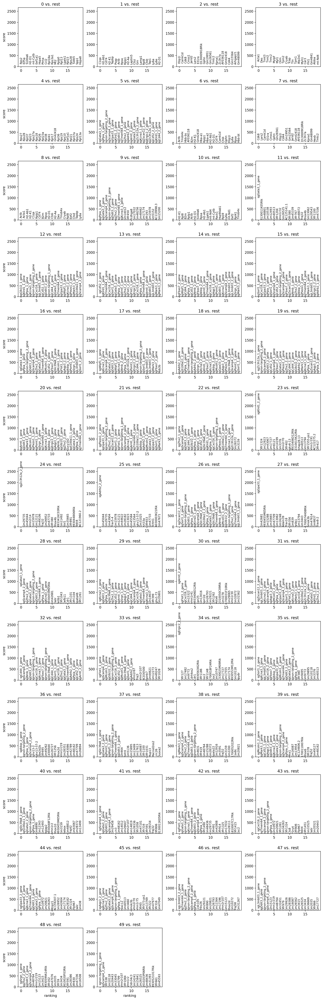

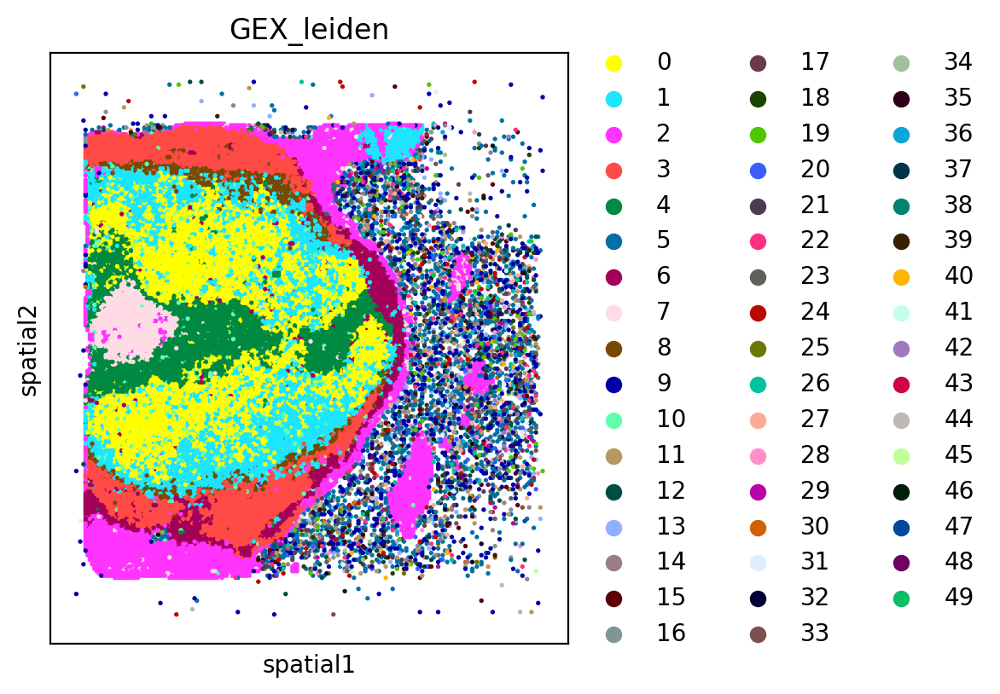

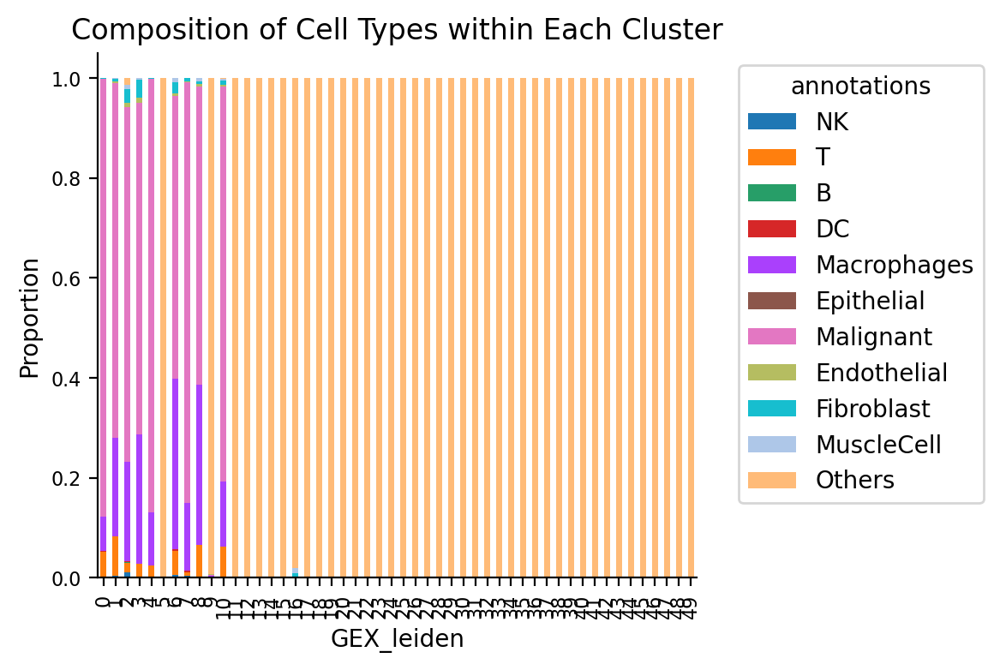

In [20]:
sc.pl.spatial(adata,  spot_size=100)

adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
adata.write_h5ad('/home/zhanghr/Analysis/data/'+ sample + ".h5ad")

### Cluster
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
adata.raw = adata.copy()
adata = adata[:,adata.var['highly_variable']]   
sc.tl.pca(adata, svd_solver="arpack")
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata,resolution = 1.2,key_added='GEX_leiden')
sc.tl.rank_genes_groups(adata, groupby='GEX_leiden') 
sc.pl.rank_genes_groups(adata)
plt.rcParams["figure.figsize"] = (4.5, 4.5)
sc.pl.spatial(adata, img_key=None, color="GEX_leiden", size=2, spot_size=100)

cluster_composition = calculate_composition(adata, 'GEX_leiden', 'annotations')
plot_composition(cluster_composition, 'Composition of Cell Types within Each Cluster', "GEX_leiden", "annotations", palette=list(adata.uns['annotations_colors']))

adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
adata.write_h5ad('/home/zhanghr/Analysis/data/'+ sample + "_3kHVGsCluster.h5ad")
del(adata)

In [21]:
sc.tl.leiden(adata,resolution = 1.2,key_added='GEX_leiden')
sc.tl.rank_genes_groups(adata, groupby='GEX_leiden') 
sc.pl.rank_genes_groups(adata)
plt.rcParams["figure.figsize"] = (4.5, 4.5)
sc.pl.spatial(adata, img_key=None, color="GEX_leiden", size=2, spot_size=100)

cluster_composition = calculate_composition(adata, 'GEX_leiden', 'annotations')
plot_composition(cluster_composition, 'Composition of Cell Types within Each Cluster', "GEX_leiden", "annotations", palette=list(adata.uns['annotations_colors']))

adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
adata.write_h5ad('/home/zhanghr/Analysis/data/'+ sample + "_3kHVGsCluster.h5ad")
del(adata)

NameError: name 'adata' is not defined

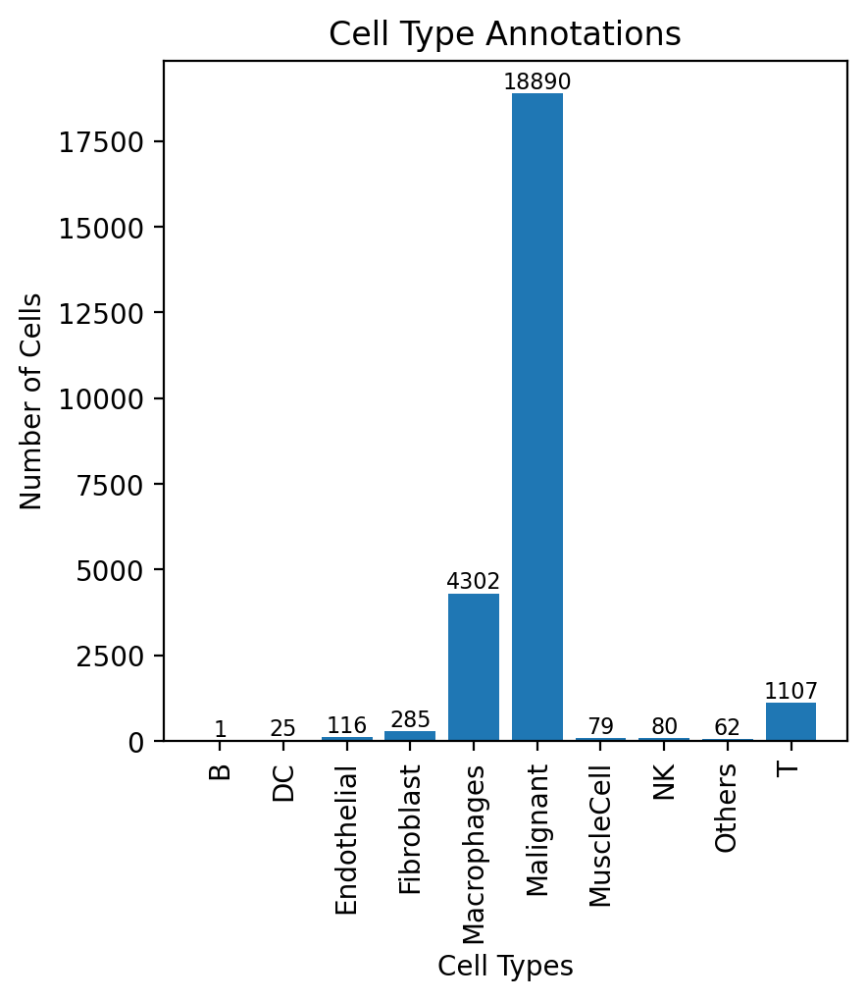

ranking genes
skip


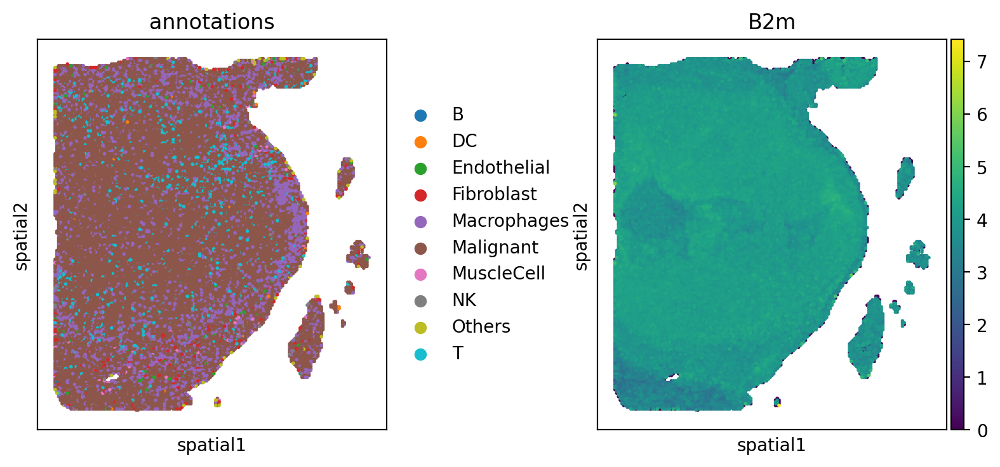

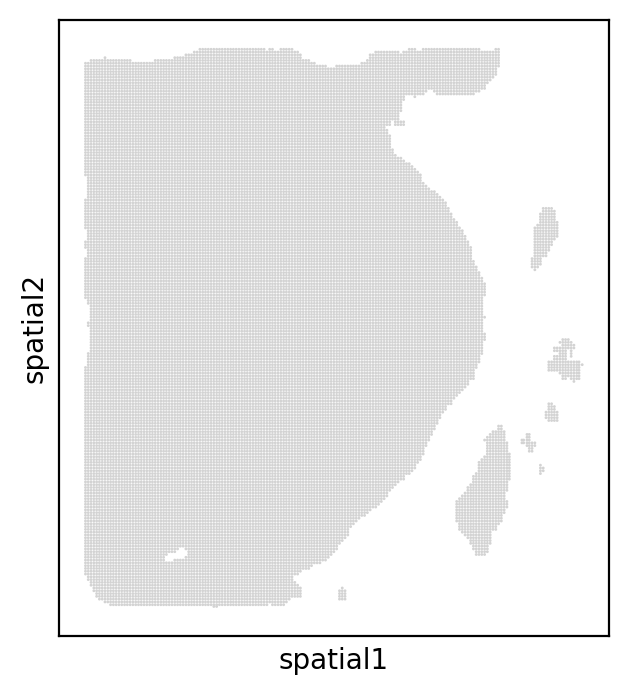

In [28]:
    visualize_results(adata)
    plt.rcParams['figure.figsize']=(4,4)
    try:
        sc.tl.rank_genes_groups(adata, groupby='annotations') 
        sc.pl.rank_genes_groups(adata)
    except:
        print('skip')

    sc.pl.spatial(adata, color=["annotations",'B2m'], size=2, img_key=None, spot_size=100)
    sc.pl.spatial(adata,  spot_size=100)

    adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
    adata.write_h5ad('/home/zhanghr/Analysis/data/'+ sample + ".h5ad")

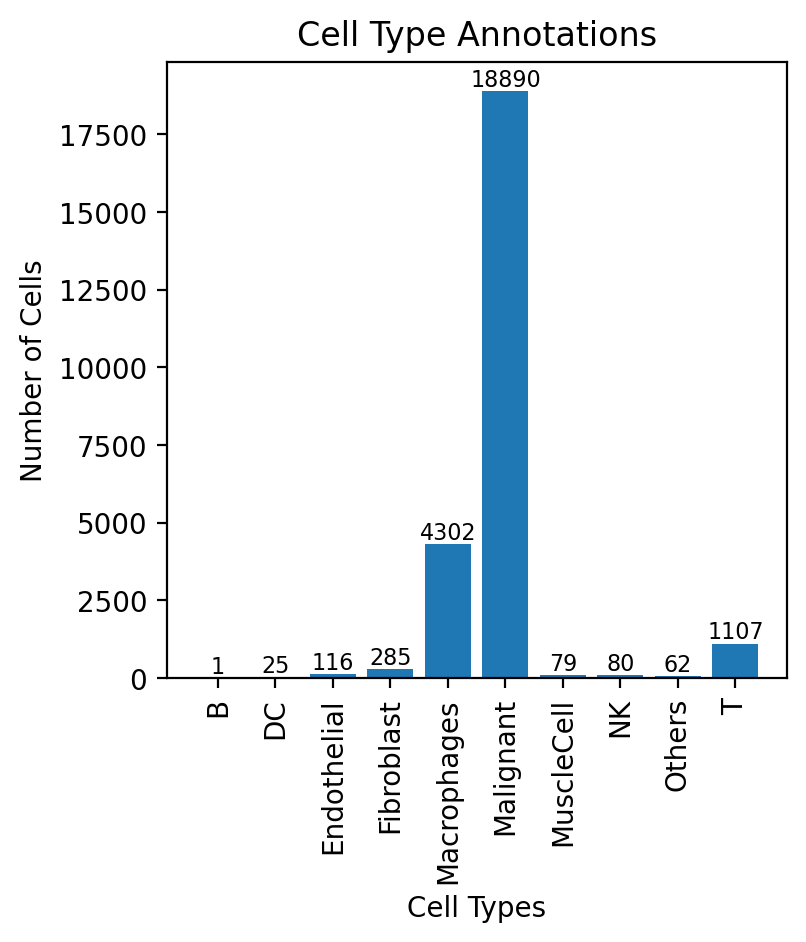

ranking genes
skip


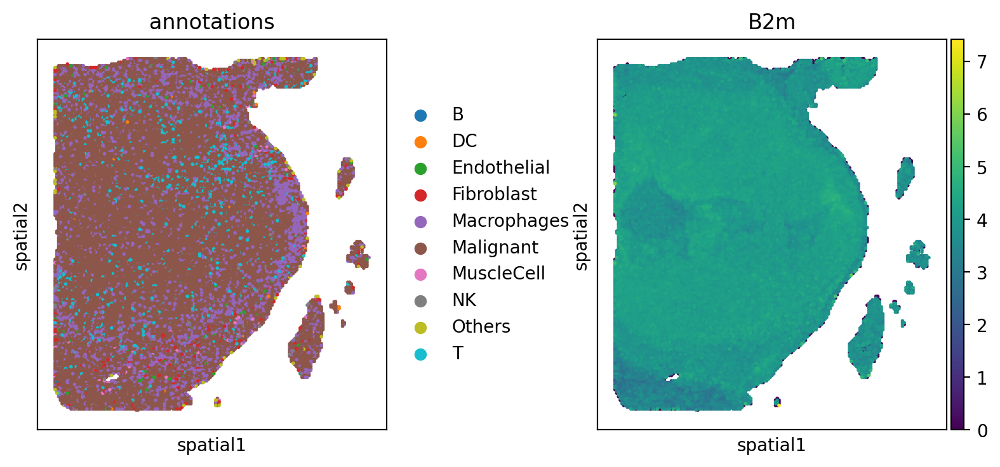

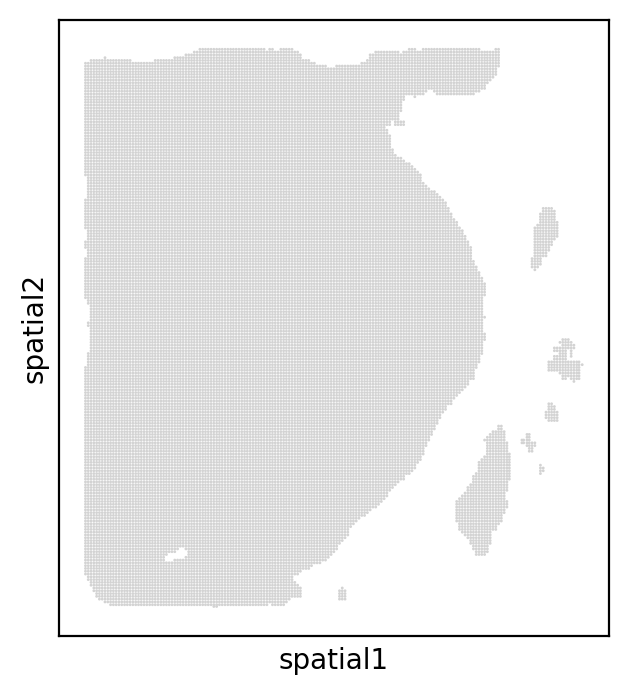

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:33)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)
running Leiden clustering
    finished: found 12 clusters and added
    'GEX_leiden', the cluster labels (adata.obs, categorical) (0:00:05)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to

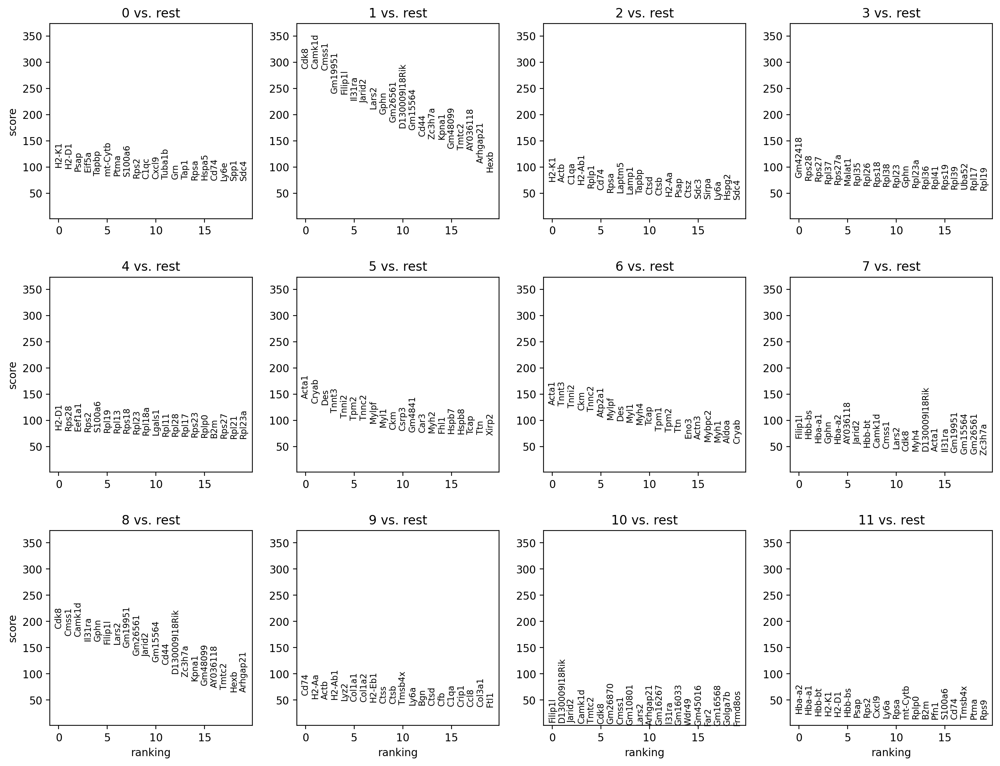

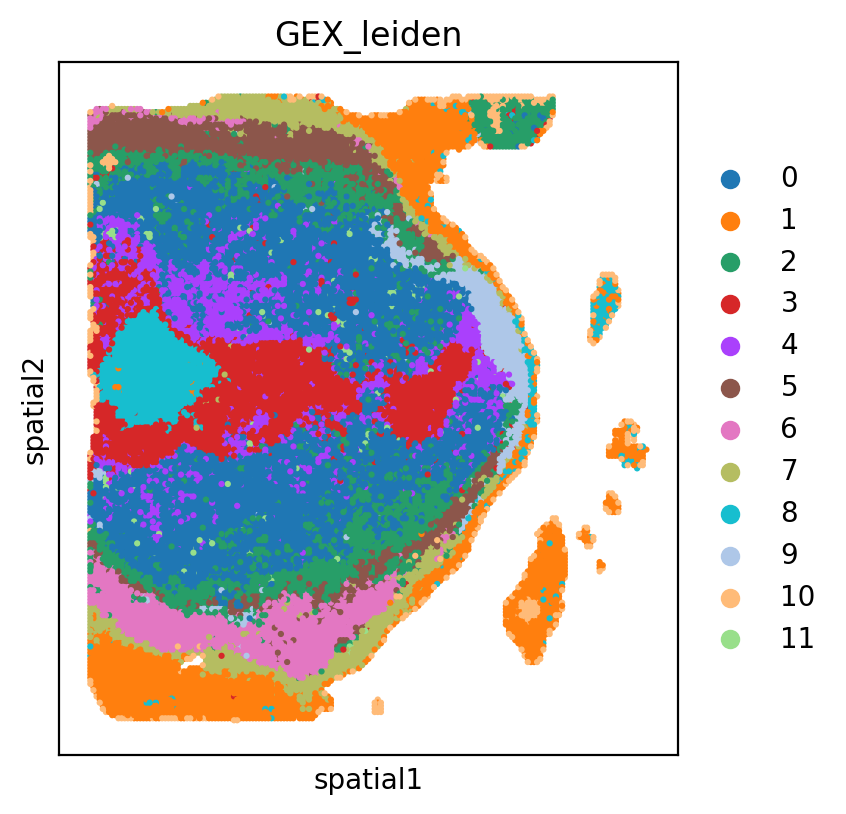

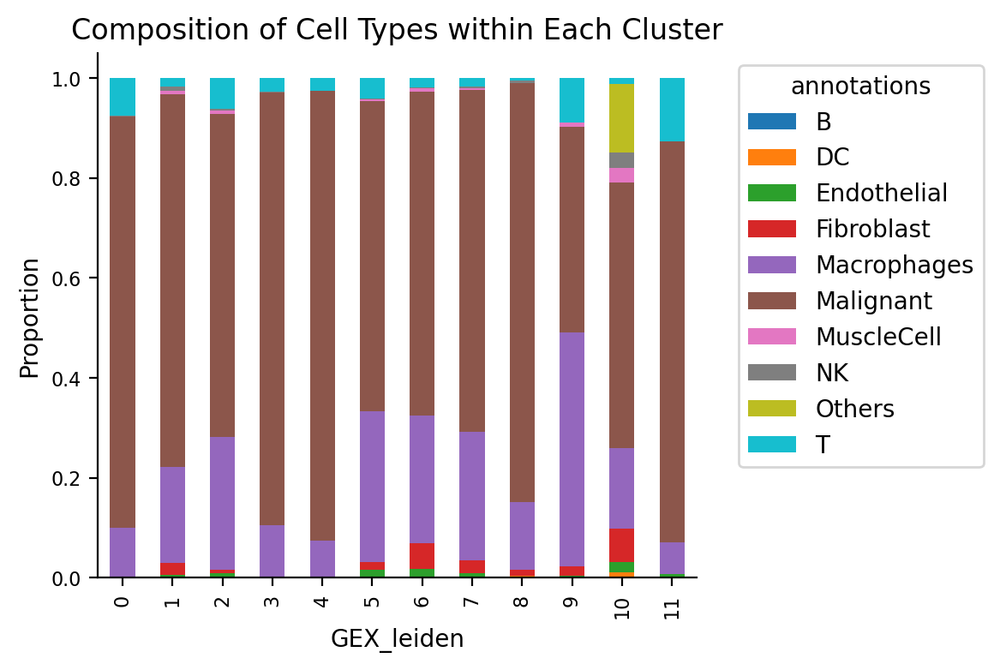

In [30]:
   ### Cluster
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
adata.raw = adata.copy()
adata = adata[:,adata.var['highly_variable']]   
sc.tl.pca(adata, svd_solver="arpack")
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata,key_added='GEX_leiden')
sc.tl.rank_genes_groups(adata, groupby='GEX_leiden') 
sc.pl.rank_genes_groups(adata)
plt.rcParams["figure.figsize"] = (4.5, 4.5)
sc.pl.spatial(adata, img_key=None, color="GEX_leiden", size=2, spot_size=100)

cluster_composition = calculate_composition(adata, 'GEX_leiden', 'annotations')
plot_composition(cluster_composition, 'Composition of Cell Types within Each Cluster', "GEX_leiden", "annotations", palette=list(adata.uns['annotations_colors']))

adata.obsm['spatial'] = np.array(adata.obsm['spatial']).astype(int)
adata.write_h5ad('/home/zhanghr/Analysis/data/'+ sample + "_3kHVGsCluster.h5ad")
